In [5]:
import pandas as pd
import seaborn as sns

In [3]:
data = pd.read_csv("./data.csv")
data.describe()
data = data.drop(columns='id')
data

,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,f_09,...,f_19,f_20,f_21,f_22,f_23,f_24,f_25,f_26,f_27,f_28
0,-0.389420,-0.912791,0.648951,0.589045,-0.830817,0.733624,2.258560,2,13,14,...,-0.478412,-0.757002,-0.763635,-1.090369,1.142641,-0.884274,1.137896,1.309073,1.463002,0.813527
1,-0.689249,-0.453954,0.654175,0.995248,-1.653020,0.863810,-0.090651,2,3,6,...,-0.428791,-0.089908,-1.784204,-0.839474,0.459685,1.759412,-0.275422,-0.852168,0.562457,-2.680541
2,0.809079,0.324568,-1.170602,-0.624491,0.105448,0.783948,1.988301,5,11,5,...,-0.413534,-1.602377,1.190984,3.267116,-0.088322,-2.168635,-0.974989,1.335763,-1.110655,-3.630723
3,-0.500923,0.229049,0.264109,0.231520,0.415012,-1.221269,0.138850,6,2,13,...,0.619283,1.287801,0.532837,1.036631,-2.041828,1.440490,-1.900191,-0.630771,-0.050641,0.238333
4,-0.671268,-1.039533,-0.270155,-1.830264,-0.290108,-1.852809,0.781898,8,7,5,...,-1.628830,-0.434948,0.322505,0.284326,-2.438365,1.473930,-1.044684,1.602686,-0.405263,-1.987263
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97995,0.237591,1.657034,-0.689282,0.313710,-0.299039,0.329139,1.607378,5,7,8,...,-0.290116,-0.258141,-0.973640,1.369508,0.391055,2.152426,-0.208944,-1.475403,0.298448,0.445039
97996,0.322696,0.710411,0.562625,-1.321713,-0.357708,0.182024,0.178558,3,9,2,...,0.117687,1.388242,0.342400,1.680537,-0.860409,0.579165,1.162692,0.134994,0.994666,0.727642
97997,-0.249364,-0.459545,1.886122,-1.340310,0.195029,-0.559520,-0.379767,8,9,10,...,-0.850223,-1.787648,-1.268115,-1.508330,1.945622,1.503645,0.194968,2.142693,1.646042,0.641466
97998,0.311408,2.185237,0.761367,0.436723,0.464967,0.062321,-0.334025,1,8,11,...,-0.010839,1.118906,1.565765,0.358480,0.547615,1.224439,-0.537998,-1.610954,-0.616227,-0.066211


In [35]:
from ydata_profiling import ProfileReport

data_profile = ProfileReport(df=data.T, title="Analysis of the Movies dataframe", explorative=True)
data_profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [11]:
data2 = data.loc[:, data.mean() > 1]
data.std()**2


f_00     1.005610
f_01     1.001484
f_02     1.002748
f_03     1.000845
f_04     1.006132
f_05     1.001063
f_06     0.994874
f_07    13.629684
f_08    17.241995
f_09    34.868064
f_10    22.092121
f_11    17.615701
f_12    19.654223
f_13    16.975033
f_14     0.997880
f_15     1.002193
f_16     1.006565
f_17     1.002517
f_18     0.991947
f_19     1.008763
f_20     1.005933
f_21     0.999406
f_22     2.184065
f_23     2.234533
f_24     2.380892
f_25     2.484046
f_26     2.039341
f_27     1.704088
f_28     2.336239
dtype: float64

<AxesSubplot: >

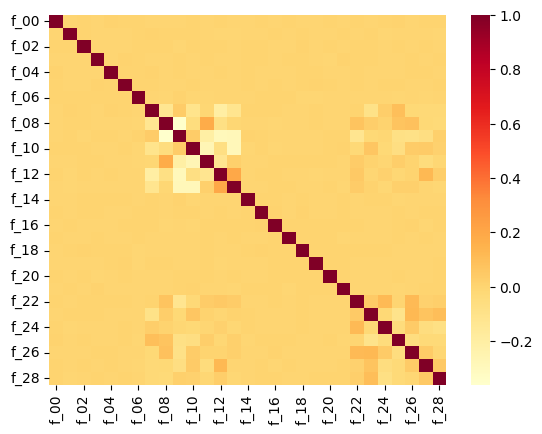

In [7]:
sns.heatmap(data.corr(), cmap='YlOrRd')


<AxesSubplot: >

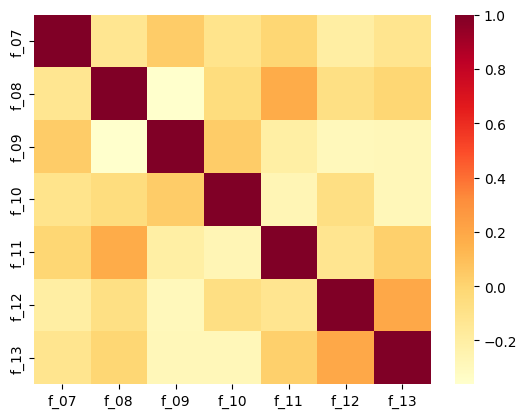

In [8]:
sns.heatmap(data2.corr(), cmap='YlOrRd')


In [16]:
from sklearn.feature_selection import VarianceThreshold
#we create a variance threshold object
sel = VarianceThreshold(threshold=1)
#we apply the method to the data - this method does not create a new dataframe, just a numpy array
data_variance_removed = sel.fit_transform(data)
#we can create a new dataframe using the get_feature_names_out() function to get the names of the selected columns
dataframe_variance_removed = pd.DataFrame(data_variance_removed, columns = sel.get_feature_names_out())
dataframe_variance_removed

,f_00,f_01,f_02,f_03,f_04,f_05,f_07,f_08,f_09,f_10,...,f_17,f_19,f_20,f_22,f_23,f_24,f_25,f_26,f_27,f_28
0,-0.389420,-0.912791,0.648951,0.589045,-0.830817,0.733624,2.0,13.0,14.0,5.0,...,-0.559650,-0.478412,-0.757002,-1.090369,1.142641,-0.884274,1.137896,1.309073,1.463002,0.813527
1,-0.689249,-0.453954,0.654175,0.995248,-1.653020,0.863810,2.0,3.0,6.0,4.0,...,-0.030798,-0.428791,-0.089908,-0.839474,0.459685,1.759412,-0.275422,-0.852168,0.562457,-2.680541
2,0.809079,0.324568,-1.170602,-0.624491,0.105448,0.783948,5.0,11.0,5.0,8.0,...,-0.288042,-0.413534,-1.602377,3.267116,-0.088322,-2.168635,-0.974989,1.335763,-1.110655,-3.630723
3,-0.500923,0.229049,0.264109,0.231520,0.415012,-1.221269,6.0,2.0,13.0,8.0,...,-1.521753,0.619283,1.287801,1.036631,-2.041828,1.440490,-1.900191,-0.630771,-0.050641,0.238333
4,-0.671268,-1.039533,-0.270155,-1.830264,-0.290108,-1.852809,8.0,7.0,5.0,3.0,...,0.444142,-1.628830,-0.434948,0.284326,-2.438365,1.473930,-1.044684,1.602686,-0.405263,-1.987263
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97995,0.237591,1.657034,-0.689282,0.313710,-0.299039,0.329139,5.0,7.0,8.0,5.0,...,0.409882,-0.290116,-0.258141,1.369508,0.391055,2.152426,-0.208944,-1.475403,0.298448,0.445039
97996,0.322696,0.710411,0.562625,-1.321713,-0.357708,0.182024,3.0,9.0,2.0,5.0,...,1.318554,0.117687,1.388242,1.680537,-0.860409,0.579165,1.162692,0.134994,0.994666,0.727642
97997,-0.249364,-0.459545,1.886122,-1.340310,0.195029,-0.559520,8.0,9.0,10.0,7.0,...,0.398968,-0.850223,-1.787648,-1.508330,1.945622,1.503645,0.194968,2.142693,1.646042,0.641466
97998,0.311408,2.185237,0.761367,0.436723,0.464967,0.062321,1.0,8.0,11.0,11.0,...,0.165038,-0.010839,1.118906,0.358480,0.547615,1.224439,-0.537998,-1.610954,-0.616227,-0.066211


In [55]:
from sklearn.preprocessing import Normalizer
cols = data.columns
l2 = Normalizer(norm="max").fit(data)
normalized = pd.DataFrame(l2.transform(data), columns=cols)
normalized.describe()
normalized.sum()


f_00        8.280765
f_01       39.690538
f_02      -10.146324
f_03       -9.017563
f_04      -23.556166
f_05      -13.076395
f_06      -23.472683
f_07    41066.429751
f_08    49656.240773
f_09    55697.990401
f_10    56062.685268
f_11    58370.528482
f_12    50534.888673
f_13    46398.588130
f_14       18.120619
f_15      -24.010495
f_16       39.739900
f_17       19.632160
f_18      -37.137314
f_19      -35.009994
f_20       -3.873543
f_21      -16.565592
f_22     -139.679268
f_23    -1673.858663
f_24     1269.556587
f_25     -253.266724
f_26     -362.295238
f_27      694.440132
f_28    -1789.586085
dtype: float64

In [1]:
from sklearn.metrics import davies_bouldin_score, silhouette_score
from sklearn.cluster import KMeans
from tqdm.notebook import tqdm

k_range = range(3,3)

scores = []

for k in tqdm(k_range):
    kmeans = KMeans(n_clusters=k)
    labels = kmeans.fit_predict(normalized)
    score_db = davies_bouldin_score(normalized, labels)
    score_silhouette = silhouette_score(normalized, labels, metric='euclidean')
    scores.append((k, score_db, score_silhouette))

scores

0it [00:00, ?it/s]

[]

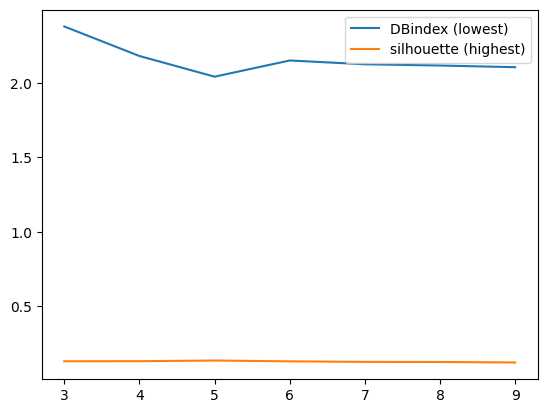

In [57]:
import matplotlib.pyplot as plt 

y, v1, v2 = list(zip(*scores))



plt.plot(y,v1, label= "DBindex (lowest) ")
plt.plot(y,v2, label="silhouette (highest)")
plt.legend()
plt.show()